<a href="https://colab.research.google.com/github/MarceloClaro/COR-INPE/blob/master/determinarcor.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **PLATAFORMA DE DIDÁTICA EM RECONHECIMENTO DE CORES EM IMAGENS DE SATÉLITES.**
**# INTRODUÇÃO MACHINE LEARNING NO CURRICULO DAS CIÊNCIAS HUMANAS E SUAS TECNOLOGIAS.**

 **OBJETIVOS:** - AUXILIAR OS GEOGRAFOS, PROFESSORES E DISCENTES, NA ANÁLISE DE CORES EM IMAGENS TIRADAS POR SATÉLITES, BUSCANDO CRIAR GRÁFICOS DE AGRUPAMENTOS DE CORES DOMINANTES E QUANTIFICÁ-LAS EM PORCENTAGEM, FACILITANDO SUA INTERPRETAÇÃO E DANDO ACESSO AOS PROFISSIONAIS COM COMPROMETIMENTO DE ACUIDADE VISUAL A INTERPRETAÇÕES NÚMERICAS,  ESTUDAR E DESENVOLVER APLICABILIDADES DOS CONHECIMENTOS DAS CIÊNCIAS DE DADOS NAS CIÊNCIAS HUMANAS. PRINCIPALMENTE MINERAÇÃO DE DADOS E APRENDIZAGEM DE MAQUINA (MACHINE LEARNING)
 
**OBJETIVO ESPECÍFICO:** - CALCULAR E IDENTIFICAR ATRAVÉS DE IMAGENS, AS CORES, DE FORMA MAIS EFICAZ, ATRAVÉS DA REFERÊNCIA CRUZADA DE NOMES DE CORES ISCC-NBS COM SUA REPRESENTATIVIDADE QUANTITATIVA NA IMAGEM EM PORCENTAGEM, PARA ESTUDOS DE COBERTURA VEGETAL E DE OUTROS ASPECTOS,- POSSIBILITAR A INTEGRAÇÃO DE PESSOAS COM BAIXA ACUIDADE VISUAL E PORTADORES DE DALTONISMO ÀS AULAS PRÁTICAS DE CARTOGRAFIA.

**MATERIAIS NECESSÁRIOS:** - NOTEBOOK / SMARTPHONE, IMAGEM DE SATELITE (LADSAT8) 
GOOGLE COLABORATORY (SERVIÇO DE NUVEM GRATUITO HOSPEDADO PELO GOOGLE PARA INCENTIVAR A PESQUISA DE APRENDIZAGEM DE MÁQUINA E INTELIGÊNCIA ARTIFICIAL). 

**PRODUTO DA AÇÃO:** UM CÓDIGO DE RECONHECIMENTO DE CORES DE IMAGENS DE SATÉLITES, QUE IDENTIFICARÁ AS CORES ATRAVÉS DA EXTRAÇÃO DAS PALETAS DE CORES, USANDO UMA LINHA DE PROGRAMAÇÃO EM LINGUAGEM PYTHON, UTILIZANDO BIBLIOTECAS QUE POSSIBILITAM MÉTODOS NÃO-SUPERVISIONADOS DE MACHINE LEARNING (AGRUPANDO COM O KMEANS DO SCIKIT-LEARN) PARA EXTRAIR CORES DAS IMAGENS. OS CÁLCULOS DE SIMILARIDADES DE CORES DOMINANTES SÃO FEITOS PELA TÉCNICA DE APRENDIZADO DE MÁQUINA. PROJETO COLABORATIVO EM ANDAMENTO, PODE SER ACESSADO ATRAVÉS DE:

https://colab.research.google.com/github/MarceloClaro/COR-INPE/blob/master/determinarcor.ipynb

https://github.com/MarceloClaro/COR-INPE/blob/master/determinarcor.ipynb 


# **PROBLEMATIZAÇÃO:** 
- Analisar imagens com código pode ser difícil. Como fazer um código "entender" o contexto de uma imagem, no qual, essa imagem de satélites possui milhares de pixels de tons de cores e que determinado grupo de tons, representam uma cobertura vegetativa da superfície, e com isso, substituir também a habilidade físico-cognitiva da visão, fornecendo para aqueles que possuiem limitações na acuidade visual, dados alfanuméricos que possam ser interpretados, sem o apelo visual da iamgem em si? 


# **METODOLOGIA:**
- Em geral, o primeiro passo da  análise de imagens com Aprendisagem de Máquina (AI) é encontrar as cores dominantes. 
- Neste código, vamos encontrar cores dominantes nas imagens usando  matplotlib. Encontrar cores dominantes também é algo que você pode fazer com APIs ( é um conjunto de rotinas e padrões de programação para acesso a um aplicativo de software ou plataforma baseado na Web) de terceiros, mas vamos construir nosso próprio sistema para fazer isso, para que tenhamos total controle sobre o processo.
- Primeiro, analisaremos a conversão de uma imagem em suas cores componentes na forma de uma matriz e, em seguida, executaremos o **k-means** em cluster para encontrar as cores dominantes agrupando-as.


> **k-means** - Em mineração de dados, agrupamento k-means é um método de Clustering que objetiva particionar **n** observações dentre **k** grupos onde cada observação pertence ao grupo mais próximo da média. Isso resulta em uma divisão do espaço de dados em um **Diagrama de Voronoi**.


> - **Diagrama de Voronoi** é na matemática, um tipo especial de decomposição de um dado espaço, por exemplo, um espaço métrico, determinado pela distância para uma determinada família de objetos (subconjuntos) no espaço. Estes objetos são normalmente chamados de sítios **(cor dominante)** ou geradores (apesar de nomes como “sementes” estarem também em uso). Cada sítio está associado a **célula de Voronoi** correspondente, isto é um conjunto de todos os pontos no dado espaço o qual a distância para o dado sítio não é maior que sua distância para os outros objetos. Foi nomeado de Georgy Voronoi posteriormente, e também chamado de Tesselação de Voronoi, uma Decomposição Voronoi, ou um Mosaico de Dirichlet (em homenagem a Lejeune Dirichlet). Diagramas de Voronoi podem ser encontrados em diversos campos da ciência e tecnologia, até mesmo na arte, tendo inúmeras aplicações práticas e teóricas.




![https://upload.wikimedia.org/wikipedia/commons/0/0c/Fortunes-algorithm-slowed.gif](https://upload.wikimedia.org/wikipedia/commons/0/0c/Fortunes-algorithm-slowed.gif)

> ANIMAÇÃO REPRESENTANDO A VAREDURA NA IMAGEM (TRANSFORMADA EM MATRIZ), OS PONTOS SÃO SÍTIOS - **CORES DOMINANTES**, CALCULADAS E O PROCESSO DE AGRUPAMENTO É FORMADA PELA DISTÂNCIA DOS TONS DE CORES DOMINANTES - **CENTROIDES**, ASSIM DEPOIS DE AGRUPADOS NAS **CÉLULAS DE VORONOI**, É CALCULADO A PORCENTAGEM DESSE AGRUPAMENTO EM RELAÇÃO TOTAL DE CORES.









In [ ]:
pip install colour-science

In [ ]:
import os
from collections import Counter
import colour
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt
from sklearn.cluster import KMeans
from PIL import ImageColor

In [ ]:
def rgb2hex(rgb):
    hex = "#{:02x}{:02x}{:02x}".format(int(rgb[0]), int(rgb[1]), int(rgb[2]))
    # hex = f"#{rgb[0]}{}{}"
    return hex

In [ ]:
rgb = [1, 2, 3]
hex = ["#"]
[hex.append(f"{c:}") for c in rgb]
''.join(hex)

'#123'

In [ ]:
PATH = './02_07_19 SEM FUNDO.jpg'
WIDTH = 228
HEIGHT = 228
CLUSTERS = 5


Loaded JPEG image. Size: 1782.55 KB. Dimensions: ((2134, 2184))


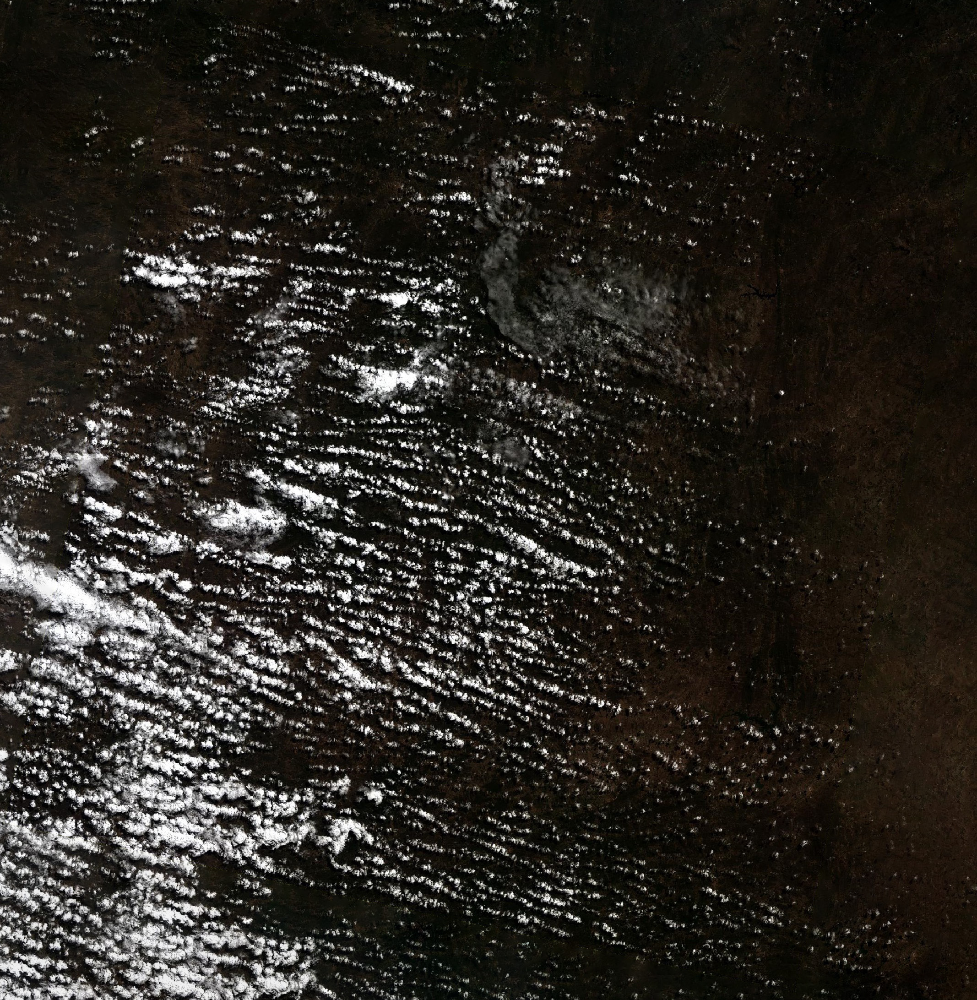

In [ ]:
image = Image.open(PATH)

image.size

print("Loaded {f} image. Size: {s:.2f} KB. Dimensions: ({d})".format(
    f=image.format, s=os.path.getsize(PATH)/1024, d=image.size))

image

In [ ]:
def calculate_new_size(image):
    if image.width >= image.height:
        wpercent = (WIDTH / float(image.width))
        hsize = int((float(image.height) * float(wpercent)))
        new_width, new_height = WIDTH, hsize
    else:
        hpercent = (HEIGHT / float(image.height))
        wsize = int((float(image.width) * float(hpercent)))
        new_width, new_height = wsize, HEIGHT
        
    image.resize((new_width, new_height), Image.ANTIALIAS)
    return image, new_width, new_height


New dimensions: 222x228


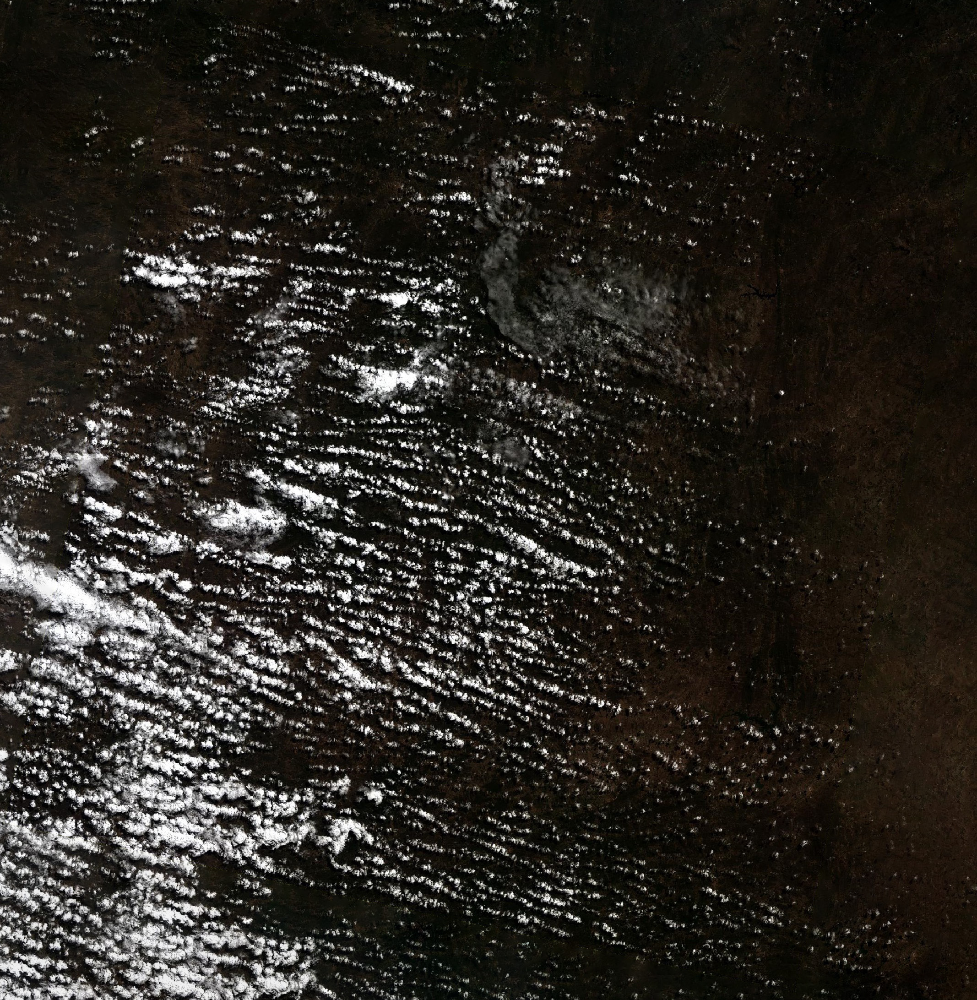

In [ ]:
new_image, new_width, new_height = calculate_new_size(image)
print(f"New dimensions: {new_width}x{new_height}")
img_array = np.array(new_image)
img_vector = img_array.reshape((img_array.shape[0] * img_array.shape[1], 3))
new_image

In [ ]:
model = KMeans(n_clusters=CLUSTERS)
labels = model.fit_predict(img_vector)
label_counts = Counter(labels)
model.cluster_centers_

array([[  39.0336386 ,   34.25487484,   28.10044744],
       [ 156.90694489,  155.68302063,  153.87386247],
       [  89.42802384,   87.60754558,   84.41346115],
       [  15.65227514,   12.69267238,    7.35611523],
       [ 231.73393486,  231.17612879,  230.39832555]])

In [ ]:
total_count = sum(label_counts.values())
total_count

4660656

In [ ]:
hex_colors = [rgb2hex(center) for center in model.cluster_centers_]
hex_colors

['#27221c', '#9c9b99', '#595754', '#0f0c07', '#e7e7e6']

In [ ]:
list(zip(hex_colors, list(label_counts.values())))


[('#27221c', 2942887),
 ('#9c9b99', 950761),
 ('#595754', 316866),
 ('#0f0c07', 231370),
 ('#e7e7e6', 218772)]

In [ ]:
plt.figure(figsize=(14, 8))

<Figure size 1008x576 with 0 Axes>

<Figure size 1008x576 with 0 Axes>

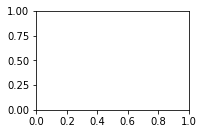

In [ ]:
plt.subplot(221)

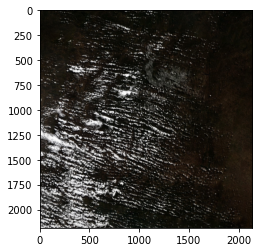

In [ ]:
plt.imshow(image)

(0.0, 1.0, 0.0, 1.0)

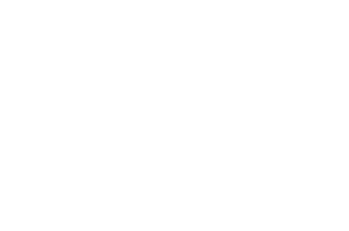

In [ ]:
plt.axis('off')

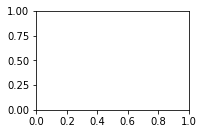

In [ ]:
plt.subplot(222)

([<matplotlib.patches.Wedge at 0x7f48104b7198>,
 [Text(-1.0075546254502759, -0.44139967912738065, '#27221c'),
  Text(1.0940441252291877, -0.11431295662129243, '#9c9b99'),
  Text(0.8045905927839094, 0.7500893133511751, '#595754'),
  Text(0.479345899173844, 0.9900643963627918, '#0f0c07'),
  Text(0.1616261784716733, 1.088061109695886, '#e7e7e6')],
 [Text(-0.5495752502456049, -0.2407634613422076, '63.1%'),
  Text(0.5967513410341023, -0.062352521793432224, '20.4%'),
  Text(0.43886759606395054, 0.40913962546427735, '6.8%'),
  Text(0.2614613995493694, 0.5400351252887954, '5.0%'),
  Text(0.08815973371182179, 0.5934878780159377, '4.7%')])

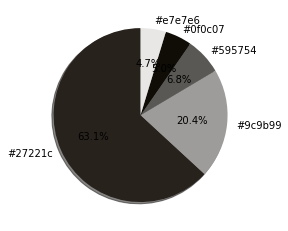

In [ ]:
plt.pie(label_counts.values(), labels=hex_colors, colors=[color / 255 for color in model.cluster_centers_],
        autopct='%1.1f%%',
        shadow=True, startangle=90)

(-0.055000000000000007,
 0.055000000000000007,
 -0.055000000000000007,
 0.055000000000000007)

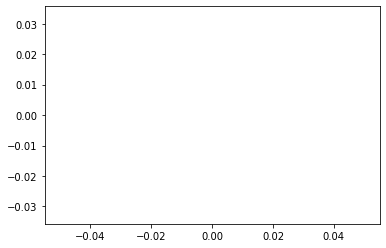

In [ ]:
plt.axis('equal')

Text(0.5, 1.0, 'IMAGEM DO INPE 02/07/2019')

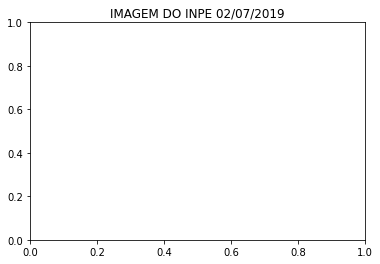

In [ ]:
plt.title('IMAGEM DO INPE 02/07/2019')

In [ ]:
plt.show()

ENCONTREI A FUNÇÃO PARA TRANSFORMAR RGB PARA MUNSELL

In [ ]:
import colour

C = colour.ILLUMINANTS['CIE 1931 2 Degree Standard Observer']['C']

RGB = (0.96820063, 0.74966853, 0.60617991)

print(colour.xyY_to_munsell_colour(colour.XYZ_to_xyY(colour.sRGB_to_XYZ(RGB, C))))

4.2YR 8.1/5.3


CÓDIGO COMPLETO PARA PLOTAGEM

Loaded JPEG image. Size: 1782.55 KB. Dimensions: ((2134, 2184))
New dimensions: 222x228


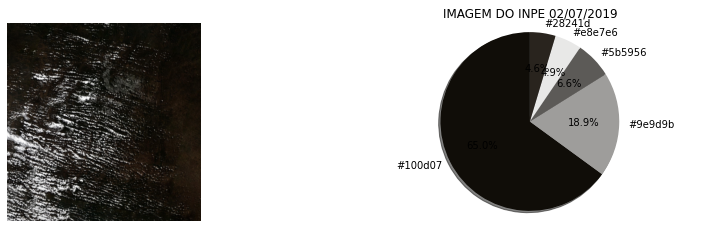

In [ ]:
import os
from collections import Counter
import colour
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt
from sklearn.cluster import KMeans
from PIL import ImageColor
def rgb2hex(rgb):
    hex = "#{:02x}{:02x}{:02x}".format(int(rgb[0]), int(rgb[1]), int(rgb[2]))
    # hex = f"#{rgb[0]}{}{}"
    return hex
rgb = [1, 2, 3]
hex = ["#"]
[hex.append(f"{c:}") for c in rgb]
''.join(hex)
PATH = './02_07_19 SEM FUNDO.jpg'
WIDTH = 228
HEIGHT = 228
CLUSTERS = 5
image = Image.open(PATH)

image.size

print("Loaded {f} image. Size: {s:.2f} KB. Dimensions: ({d})".format(
    f=image.format, s=os.path.getsize(PATH)/1024, d=image.size))

image
def calculate_new_size(image):
    if image.width >= image.height:
        wpercent = (WIDTH / float(image.width))
        hsize = int((float(image.height) * float(wpercent)))
        new_width, new_height = WIDTH, hsize
    else:
        hpercent = (HEIGHT / float(image.height))
        wsize = int((float(image.width) * float(hpercent)))
        new_width, new_height = wsize, HEIGHT
        
    image.resize((new_width, new_height), Image.ANTIALIAS)
    return image, new_width, new_height
new_image, new_width, new_height = calculate_new_size(image)
print(f"New dimensions: {new_width}x{new_height}")
img_array = np.array(new_image)
img_vector = img_array.reshape((img_array.shape[0] * img_array.shape[1], 3))
new_image
model = KMeans(n_clusters=CLUSTERS)
labels = model.fit_predict(img_vector)
label_counts = Counter(labels)
model.cluster_centers_
total_count = sum(label_counts.values())
total_count
hex_colors = [rgb2hex(center) for center in model.cluster_centers_]
hex_colors
list(zip(hex_colors, list(label_counts.values())))
plt.figure(figsize=(14, 8))
plt.subplot(221)
plt.imshow(image)
plt.axis('off')
plt.subplot(222)
plt.pie(label_counts.values(), labels=hex_colors, colors=[color / 255 for color in model.cluster_centers_],
        autopct='%1.1f%%',
        shadow=True, startangle=90)
plt.axis('equal')
plt.title('IMAGEM DO INPE 02/07/2019')
plt.show()